In [1]:
import os

import matplotlib as mpl
import matplotlib.pyplot as plt
import mediapy as media
import numpy as np
import PIL
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_hub as hub
import tqdm
import cv2  

from dataloader import *

2022-08-16 02:47:10.470246: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-16 02:47:11.990491: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2022-08-16 02:47:11.990585: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2022-08-16 02:47:11.990594: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

### Data generator

In [59]:
import os

import matplotlib as mpl
import matplotlib.pyplot as plt
import mediapy as media
import numpy as np
import PIL
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_hub as hub
import tqdm
import cv2  


from keras.utils import Sequence
from keras.utils import np_utils

class DataGenerator(Sequence):
    """Data Generator inherited from keras.utils.Sequence
    Args: 
        directory: the path of data set, and each sub-folder will be assigned to one class
        batch_size: the number of data points in each batch
        shuffle: whether to shuffle the data per epoch
    Note:
        If you want to load file with other data format, please fix the method of "load_data" as you want
    """
    def __init__(self, directory, batch_size=1, shuffle=False, data_augmentation=False):
        # Initialize the params
        self.batch_size = batch_size
        self.directory = directory
        self.shuffle = shuffle
        self.data_aug = data_augmentation
        # Load all the save_path of files, and create a dictionary that save the pair of "data:label"
        self.X_path, self.Y_dict = self.search_data() 
        # Print basic statistics information
        self.print_stats()
        return None
        
    def search_data(self):
        X_path = []
        Y_dict = {}
        # list all kinds of sub-folders
        self.dirs = sorted(os.listdir(self.directory))
        one_hots = np_utils.to_categorical(range(len(self.dirs)))
        for i,folder in enumerate(self.dirs):
            folder_path = os.path.join(self.directory,folder)
            for file in os.listdir(folder_path):
                file_path = os.path.join(folder_path,file)
                # append the each file path, and keep its label  
                X_path.append(file_path)
                Y_dict[file_path] = one_hots[i]
        return X_path, Y_dict
    
    def print_stats(self):
        # calculate basic information
        self.n_files = len(self.X_path)
        self.n_classes = len(self.dirs)
        self.indexes = np.arange(len(self.X_path))
#         np.random.shuffle(self.indexes)
        # Output states
        print("Found {} files belonging to {} classes.".format(self.n_files,self.n_classes))
        for i,label in enumerate(self.dirs):
            print('%10s : '%(label),i)
        return None
    
    def __len__(self):
        # calculate the iterations of each epoch
        steps_per_epoch = np.ceil(len(self.X_path) / float(self.batch_size))
        return int(steps_per_epoch)

    def __getitem__(self, index):
        """Get the data of each batch
        """
        # get the indexs of each batch
        batch_indexs = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        # using batch_indexs to get path of current batch
        batch_path = [self.X_path[k] for k in batch_indexs]
        # get batch data
        batch_x, batch_y = self.data_generation(batch_path)
        return batch_x, batch_y

    def on_epoch_end(self):
        # shuffle the data at each end of epoch
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def data_generation(self, batch_path):
        # load data into memory, you can change the np.load to any method you want
        batch_x = [self.load_data(x) for x in batch_path]
        batch_y = [self.Y_dict[x] for x in batch_path]
        # transfer the data format and take one-hot coding for labels
        batch_x = np.array(batch_x)
        batch_y = np.array(batch_y)
        return batch_x, batch_y
      
    def normalize(self, data):
        mean = np.mean(data)
        std = np.std(data)
        return (data-mean) / std
    
    def random_flip(self, video, prob):
        s = np.random.rand()
        if s < prob:
            video = np.flip(m=video, axis=2)
        return video    
    
    def uniform_sampling(self, video, target_frames=64):
        # get total frames of input video and calculate sampling interval 
        len_frames = int(len(video))
        interval = int(np.ceil(len_frames/target_frames))
        # init empty list for sampled video and 
        sampled_video = []
        for i in range(0,len_frames,interval):
            sampled_video.append(video[i])     
        # calculate numer of padded frames and fix it 
        num_pad = target_frames - len(sampled_video)
        if num_pad>0:
            padding = [video[i] for i in range(-num_pad,0)]
            sampled_video += padding     
        # get sampled video
        return np.array(sampled_video, dtype=np.float32)
    
    def dynamic_crop(self, video):
        # extract layer of optical flow from video
        opt_flows = video[...,3]
        # sum of optical flow magnitude of individual frame
        magnitude = np.sum(opt_flows, axis=0)
        # filter slight noise by threshold 
        thresh = np.mean(magnitude)
        magnitude[magnitude<thresh] = 0
        # calculate center of gravity of magnitude map and adding 0.001 to avoid empty value
        x_pdf = np.sum(magnitude, axis=1) + 0.001
        y_pdf = np.sum(magnitude, axis=0) + 0.001
        # normalize PDF of x and y so that the sum of probs = 1
        x_pdf /= np.sum(x_pdf)
        y_pdf /= np.sum(y_pdf)
        # randomly choose some candidates for x and y 
        x_points = np.random.choice(a=np.arange(224), size=10, replace=True, p=x_pdf)
        y_points = np.random.choice(a=np.arange(224), size=10, replace=True, p=y_pdf)
        # get the mean of x and y coordinates for better robustness
        x = int(np.mean(x_points))
        y = int(np.mean(y_points))
        # avoid to beyond boundaries of array
        x = max(56,min(x,167))
        y = max(56,min(y,167))
        # get cropped video 
        return video[:,x-56:x+56,y-56:y+56,:]  
    
    def color_jitter(self,video):
        # range of s-component: 0-1
        # range of v component: 0-255
        s_jitter = np.random.uniform(-0.2,0.2)
        v_jitter = np.random.uniform(-30,30)
        for i in range(len(video)):
            hsv = cv2.cvtColor(video[i], cv2.COLOR_RGB2HSV)
            s = hsv[...,1] + s_jitter
            v = hsv[...,2] + v_jitter
            s[s<0] = 0
            s[s>1] = 1
            v[v<0] = 0
            v[v>255] = 255
            hsv[...,1] = s
            hsv[...,2] = v
            video[i] = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
        return video
        
    def load_data(self, path):
        data = np.load(path)
        data = np.float32(data)
        # sampling 64 frames uniformly from the entire video
#         data = self.uniform_sampling(video=data, target_frames=64)
        # whether to utilize the data augmentation
        if  self.data_aug:
            data = self.color_jitter(data)
            data = self.random_flip(data, prob=0.5)
        # normalize
#         data = self.normalize(data)
        return data

In [60]:
batch_size = 1
num_frames = 64
frame_stride = 0
resolution = 224

val_generator = DataGenerator(directory='/home/ahreumseo/research/violence/datasets/RWF2000-Video-Database-for-Violence-Detection/Dataset/dataset_npy_rgb/val',
                              batch_size=batch_size, 
                              data_augmentation=False,
                             shuffle=False)

Found 400 files belonging to 2 classes.
     Fight :  0
  NonFight :  1


### Load model 

In [3]:
# Run imports
import tensorflow_datasets as tfds

from official.vision.configs import video_classification
from official.projects.movinet.configs import movinet as movinet_configs
from official.projects.movinet.modeling import movinet
from official.projects.movinet.modeling import movinet_layers
from official.projects.movinet.modeling import movinet_model

/home/ahreumseo/anaconda/envs/tf2/lib/python3.8/site-packages/tensorflow_addons/utils/ensure_tf_install.py:37: UserWarning: You are currently using a nightly version of TensorFlow (2.11.0-dev20220813). 
TensorFlow Addons offers no support for the nightly versions of TensorFlow. Some things might work, some other might not. 
If you encounter a bug, do not file an issue on GitHub.
  warnings.warn(


In [4]:
model = tf.keras.models.load_model('/home/ahreumseo/research/violence/datasets/MoViNet-TF/models/official/projects/movinet/rwf-2000_3')
model.summary()

2022-08-16 02:47:15.796804: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudnn.so.8'; dlerror: libcudnn.so.8: cannot open shared object file: No such file or directory
2022-08-16 02:47:15.796851: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1934] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2022-08-16 02:47:15.797162: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Model: "movinet_classifier_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image (InputLayer)          [(None, None, None, None  0         
                             , 3)]                               
                                                                 
 movinet (Movinet)           ({'stem': (None, None, N  2738754   
                             one, None, 16),                     
                              'block0_layer0': (None,            
                              None, None, None, 16),             
                              'block0_layer1': (None,            
                              None, None, None, 16),             
                              'block0_layer2': (None,            
                              None, None, None, 16),             
                              'block1_layer0': (None,            
                              None, None, None

                              None, None, 240),                  
                              'state_block2_layer4_po            
                             ol_frame_count': (1,),              
                              'state_block3_layer0_po            
                             ol_buffer': (None, None,            
                              None, None, 240),                  
                              'state_block3_layer0_po            
                             ol_frame_count': (1,),              
                              'state_block3_layer1_po            
                             ol_buffer': (None, None,            
                              None, None, 240),                  
                              'state_block3_layer1_po            
                             ol_frame_count': (1,),              
                              'state_block3_layer2_po            
                             ol_buffer': (None, None,            
          

### Test with sample data

""

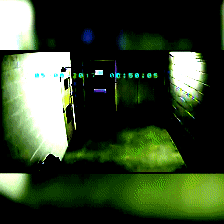

In [23]:
video = val_generator[49]
# video = np.load('/home/ahreumseo/research/violence/datasets/RWF2000-Video-Database-for-Violence-Detection/Dataset/dataset_npy/val/NonFight/6Rl7q_kXYbg_0.npy', mmap_mode='r')
# video = np.float32(video)
# video = uniform_sampling(video)
# video = normalize(video)
# video = np.expand_dims(video, 0)

media.show_videos(video[0], codec='gif', fps=30)

In [31]:
pred = model(video[0])

In [ ]:
[-0.8761903 ,  0.88107896]

In [32]:
pred

<tf.Tensor: shape=(1, 2), dtype=float32, numpy=array([[-0.9587453,  0.9533125]], dtype=float32)>

In [27]:
print(f'labels: {np.argmax(video[1], axis=1)}, \n pred:{np.argmax(pred,axis=1)}')

labels: [0], 
 pred:[1]


### Error analysis

In [9]:
errors = [14, 41, 49, 52, 59, 78, 85, 140, 154, 156, 166, 173, 176, 203, 205, 208, 222, 232, 236, 243, 255, 260, 263, 267, 276, 277, 281, 282, 297, 303, 306, 323, 334, 338, 355, 358, 364, 375, 379, 385]

In [45]:
video_violence = []
video_non_violence = []

for v in errors:
    video = val_generator[v]
    label = 'violence' if np.argmax(video[1]) == 0 else 'non-violence'
    
    if label == 'violence':
        video_violence.append(video[0])
    else:
        video_non_violence.append(video[0])

In [46]:
false_negative = np.zeros((len(video_violence),64,224,224,3))
false_positive = np.zeros((len(video_non_violence),64,224,224,3))
print(f'FP: {false_positive.shape[0]}, FN: {false_negative.shape[0]}')

FP: 27, FN: 13


In [47]:
for i in range(len(video_violence)):
    false_negative[i] = video_violence[i]

for j in range(len(video_non_violence)):
    false_positive[j] = video_non_violence[j]

In [32]:
false_positive[0:4].shape

(4, 64, 224, 224, 3)

#### False positive case

,,,,

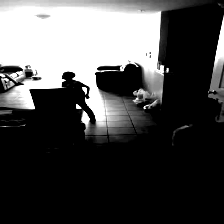
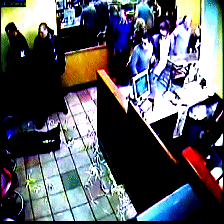
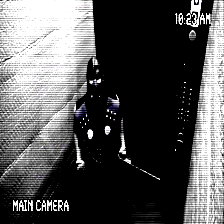
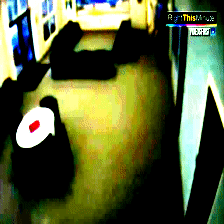
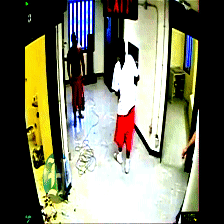

In [61]:
media.show_videos(false_positive[0:5], codec='gif', fps=30)

,,,,

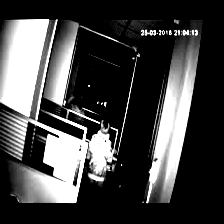
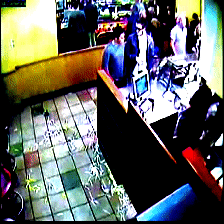
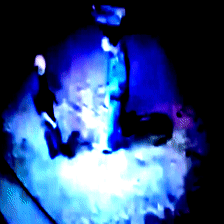
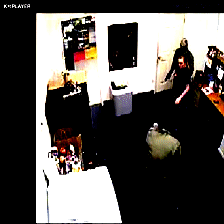
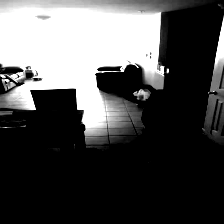

In [62]:
media.show_videos(false_positive[5:10], codec='gif', fps=30)

,,,,

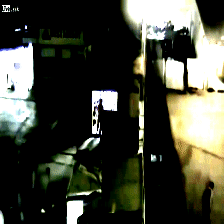
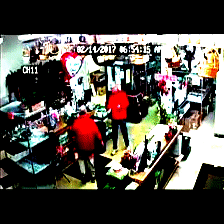
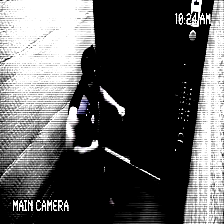
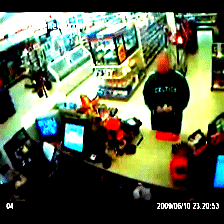
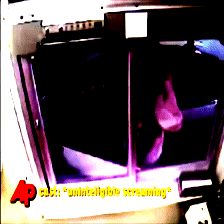

In [63]:
media.show_videos(false_positive[10:15], codec='gif', fps=30)

,,,,

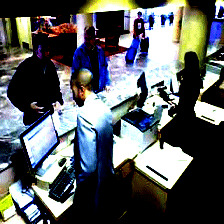
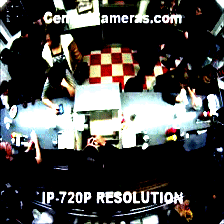
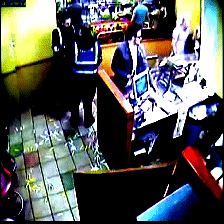
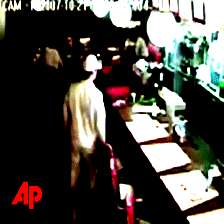
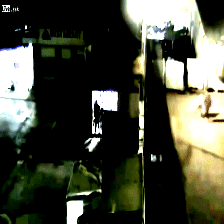

In [64]:
media.show_videos(false_positive[15:20], codec='gif', fps=30)

,,,,,,

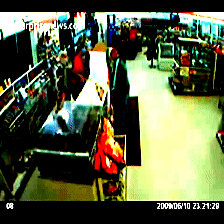
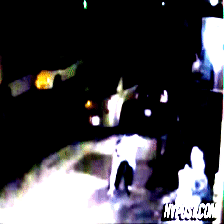
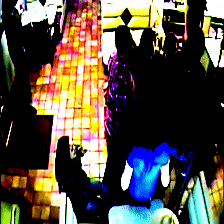
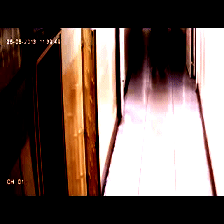
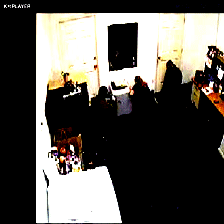
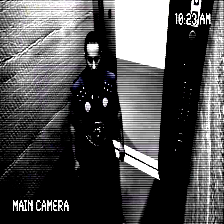
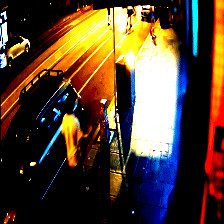

In [65]:
media.show_videos(false_positive[20:], codec='gif', fps=30)

#### False negative case

,,,,

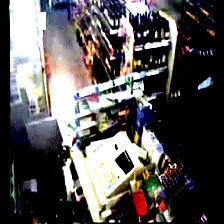
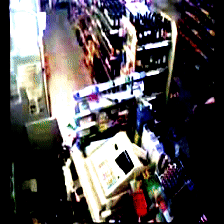
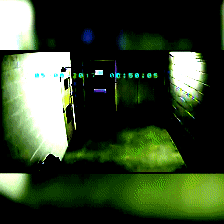
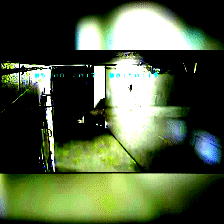
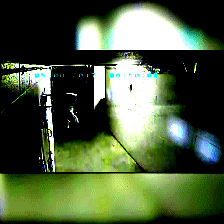

In [66]:
media.show_videos(false_negative[0:5], codec='gif', fps=30)

,,,,

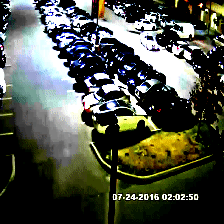
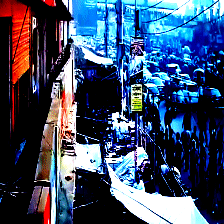
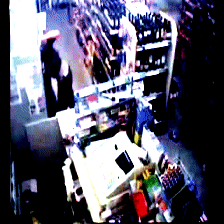
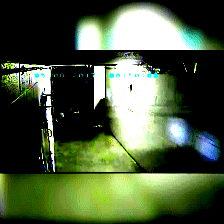
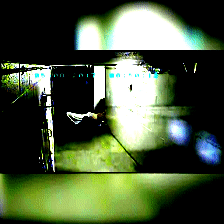

In [67]:
media.show_videos(false_negative[5:10], codec='gif', fps=30)

,,

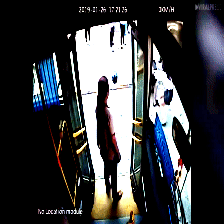
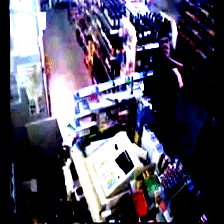
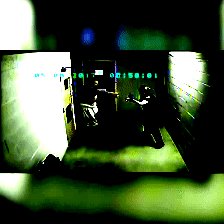

In [68]:
media.show_videos(false_negative[10:15], codec='gif', fps=30)

In [55]:
media.show_videos(false_negative[15:20], codec='gif', fps=30)

In [56]:
media.show_videos(false_negative[20:], codec='gif', fps=30)